<a href="https://colab.research.google.com/github/CharlesPrado23/Bootcamp_TurmaNoite/blob/main/Aprendizado%20N%C3%A3o-Supervisionado/K_means(Geolocation_2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
df = pd.read_csv('https://raw.githubusercontent.com/CharlesPrado23/Bootcamp_TurmaNoite/main/Aprendizado%20N%C3%A3o-Supervisionado/california_housing_train.csv')


In [18]:
df.head()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
0,-114.31,34.19,15.0,5612.0,1283.0,1015.0,472.0,1.4936,66900.0
1,-114.47,34.40,19.0,7650.0,1901.0,1129.0,463.0,1.8200,80100.0
2,-114.56,33.69,17.0,720.0,174.0,333.0,117.0,1.6509,85700.0
3,-114.57,33.64,14.0,1501.0,337.0,515.0,226.0,3.1917,73400.0
4,-114.57,33.57,20.0,1454.0,326.0,624.0,262.0,1.9250,65500.0


In [19]:
df.isna().sum()

longitude             0
latitude              0
housing_median_age    0
total_rooms           0
total_bedrooms        0
population            0
households            0
median_income         0
median_house_value    0
dtype: int64

In [20]:
df_filt = df.loc[:,['housing_median_age','latitude','longitude']]
df_filt

,housing_median_age,latitude,longitude
0,15.0,34.19,-114.31
1,19.0,34.40,-114.47
2,17.0,33.69,-114.56
3,14.0,33.64,-114.57
4,20.0,33.57,-114.57
...,...,...,...
16995,52.0,40.58,-124.26
16996,36.0,40.69,-124.27
16997,17.0,41.84,-124.30
16998,19.0,41.80,-124.30


In [21]:
property_clustering = df_filt.drop(['housing_median_age'], axis= 1)



In [22]:
property_clustering

,latitude,longitude
0,34.19,-114.31
1,34.40,-114.47
2,33.69,-114.56
3,33.64,-114.57
4,33.57,-114.57
...,...,...
16995,40.58,-124.26
16996,40.69,-124.27
16997,41.84,-124.30
16998,41.80,-124.30


# Avaliando Clusterização usando Elbow

# In cluster analysis, the elbow method is a heuristic used in determining the number of clusters in a data set. The method consists of plotting the explained variation as a function of the number of clusters, and picking the elbow of the curve as the number of clusters to use

# $ minimize\Bigg(\sum^k_{k=1}W(C_k)\Bigg) $

# where $C_k$ is the  $ k^{th} $ cluster and $W(C_k)$ is the within-cluster variation

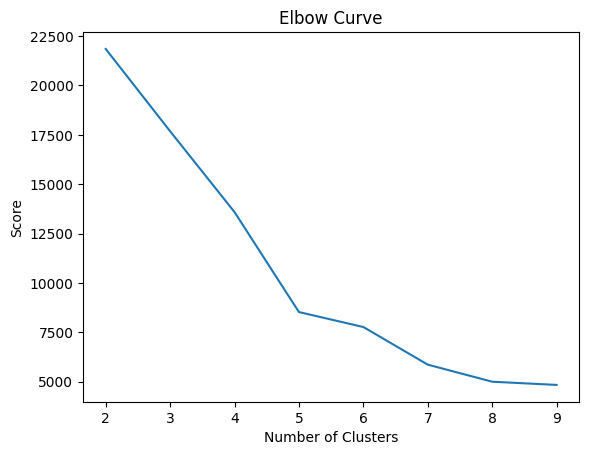

In [23]:
K_clusters = range(2,10)
kmeans = [KMeans(n_clusters=i) for i in K_clusters]


#kmeans= []
#for i in K_clusters:
#  kmeans[i] = KMeans(n_clusters=i)



Y_axis = df_filt[['latitude']]
X_axis = df_filt[['longitude']]
score = [kmeans[i].fit(property_clustering).inertia_ for i in range(len(kmeans))]

#score = [kmeans[i].fit(Y_axis).score(Y_axis) for i in range(len(kmeans))]


#score = []
#for i in range(len(kmeans)):
#  score[i]  = kmeans[i].fit(property_clustering).score(property_clustering)

# Visualize
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.show()


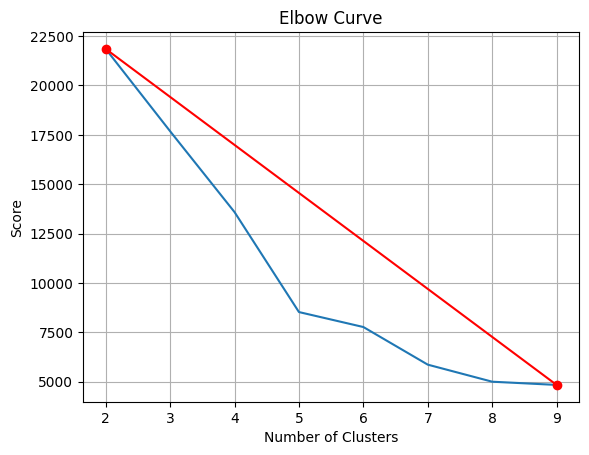

In [24]:
plt.plot(K_clusters, score)
plt.xlabel('Number of Clusters')
plt.ylabel('Score')
plt.title('Elbow Curve')
plt.plot([K_clusters[0],K_clusters[7]],[score[0],score[7]],'-ro')
plt.grid()
plt.show()


In [25]:
from sklearn.metrics import silhouette_score
for i in range(2,10):
  kmeans_ = KMeans(n_clusters=i).fit(property_clustering)
  labels_ = kmeans_.labels_
  coef = silhouette_score(property_clustering,labels_)

  print("N_cluster: {}, score: {}".format(i,coef))

N_cluster: 2, score: 0.757420342868533
N_cluster: 3, score: 0.6470167963617864
N_cluster: 4, score: 0.6211066968916277
N_cluster: 5, score: 0.6029705070498659
N_cluster: 6, score: 0.5690524812996091
N_cluster: 7, score: 0.5695103013490445
N_cluster: 8, score: 0.5397413988863723
N_cluster: 9, score: 0.5232800085621284


In [26]:
kmeans = KMeans(n_clusters = 2,random_state=0).fit(property_clustering)
kmeans.labels_
df_filt.insert(0, 'Cluster_Labels', kmeans.labels_)
df_filt.head()

,Cluster_Labels,housing_median_age,latitude,longitude
0,0,15.0,34.19,-114.31
1,0,19.0,34.40,-114.47
2,0,17.0,33.69,-114.56
3,0,14.0,33.64,-114.57
4,0,20.0,33.57,-114.57


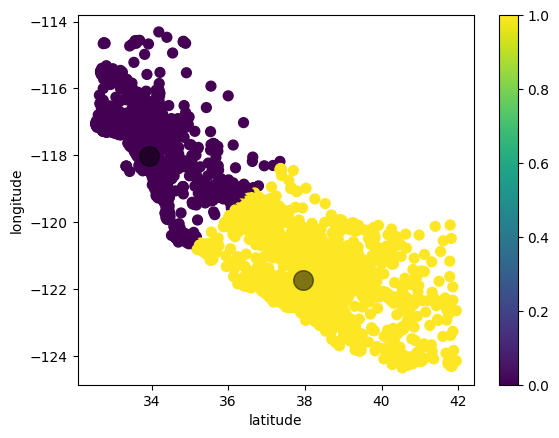

In [27]:
centers = kmeans.cluster_centers_
labels  = kmeans.labels_
df_filt.plot.scatter(x = 'latitude', y = 'longitude', c=labels, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5)

In [28]:

df6 = df_filt.groupby('Cluster_Labels')['housing_median_age'].mean()

In [29]:
df6.head()

Cluster_Labels
0    28.341881
1    28.931595
Name: housing_median_age, dtype: float64

In [30]:
pip install folium

In [31]:
#!pip install folium
import folium # plotting library

In [32]:
centers[0][0]

33.937569155942846

In [33]:
map = folium.Map(location=[-22.9711,-43.1823], zoom_start=13)

In [34]:
map

In [35]:
map = folium.Map(location=[centers[0][0], centers[0][1]], zoom_start=13)

for lat, lng , label in zip(df_filt.latitude, df_filt.longitude,df_filt.Cluster_Labels):
    folium.CircleMarker(
        [lat, lng],
        radius=2,
        color='blue' if label==0 else 'green',
        popup=str(label),
        fill = True,
        #fill_color = 'blue',
        fill_opacity= 0.6
    ).add_to(map)




In [36]:
map